# GCN (Graph convolutional networks)

In [0]:
import pandas as pd
import numpy as np
import scipy as sp

import networkx as nx

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation, rc

from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedShuffleSplit

import torch
import torch.nn as nn
import torch.optim as optim

from IPython.display import display, Markdown

import warnings
# Ignora deprecation warnings de matplotlib, que saltan al pintar networks.
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

# Fija la semilla para que el notebook sea reproducible.
np.random.seed(0)

## Concepto

Las redes GCN son un tipo de arquitectura para aplicar deep learning a grafos.

Nos centraremos, en particular, en redes no dirigidas, con un solo tipo de nodos y un solo tipo de arcos.



Para ilustrar el ejemplo utilizaremos la archiconocida red *Zachary's Karate Club* que podemos cargar de la libreria `networkx`.

Esta red cuenta con 34 nodos y 78 arcos. Se trata de una red de amistad entre personas que pertenencen a un mismo club de karate. En un momento dado se produce una discusión entre el administrador del club ("Officer") y el profesor ("Mr. Hi") y el club se divide en dos distintos, según las relaciones de cada uno de los miembros.

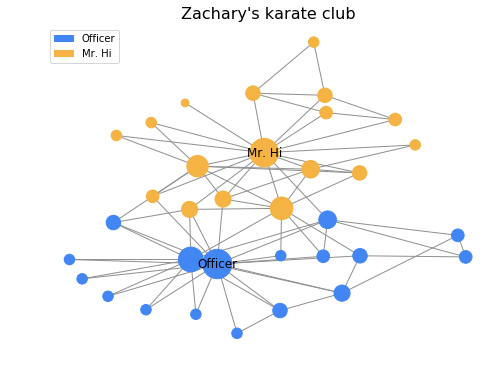

In [0]:
# Carga la red de ejemplo
G = nx.karate_club_graph()

# Calculo un layout para su representación
pos = nx.drawing.layout.kamada_kawai_layout(G)

# Representación de la red en matplotlib

club_title = "Zachary's karate club"
club_colors = {
    "Officer": "#4286f4",
    "Mr. Hi": "#f4b342" 
}

labels = nx.get_node_attributes(G, 'club')
leaders = {k: l if i == 0 or i == 33 else "" 
            for i, (k, l) in enumerate(labels.items())}

fig, ax = plt.subplots(figsize = (8, 6))
ax.set_title(club_title, fontsize = 16)
nx.draw(
    G, pos, ax = ax,
    node_size = [v * 50 + 10 for k, v in G.degree],
    node_color = [club_colors[k] for i, k in labels.items()],
    edge_color = '#909090',
    labels = leaders
)
leg = ax.legend(handles = [
    matplotlib.patches.Patch(facecolor= k, label=i) 
    for i, k in club_colors.items()
], loc = "upper left", ncol = 1)


## Definición del problema

Podemos definir cada capa de la red, de forma general, como una función de la matriz de adyacencia (la topología del grafo), las características de cada uno de los nodos y una serie de parametros entrenables.

\begin{align}
h_{ij}^{t} = f(a_{ik}, h_{km}^{t-1}, \theta_{mj}^{t-1})\\
\end{align}

En la expresión anterior $h$ representa las características en la capa $t$ y $t+1$, $a$ la matriz de adyacencia,  y $\theta$ los parámetros.



## Propagación

La propagación o reglas de propagación indican como se acumula la información de los vecinos en cada nodo.

Existen dos tipos de agregación, agregación por media y agregación espectral.

Para ambas agregaciones se utiliza la matriz de adyacencia con *self-loops*, es decir, añadiéndole la matriz identidad.

\begin{align}
 \hat{a_{ij}} = a_{ij}  + \delta_{ij}
\end{align}

También se utiliza una matriz diagonal con los grados de cada nodo.

\begin{align}
\hat{d}_{ij} = d_{ii}  \cdot \delta_{ij}
\end{align}


* Agregación media

  \begin{align}
  p_{ij} = \hat{d}_{ik}^{-1} \cdot  \hat{a_{kj}} \\
  \end{align}

* Agregación espectral

  \begin{align}
   p_{ij} = \hat{d}_{ik}^{-\frac{1}{2}} \cdot  \hat{a_{km}} \cdot  \hat{d}_{mj}^{-\frac{1}{2}} \\
  \end{align}

In [0]:
def normalize_adjacency_matrix(A, aggregation_rule = "spectral"):
    """ Calcula una versión normalizada en función del grado del nodo de la
    matriz de adyacencia. Devuelve un tensor sparse de pytorch.
    Args:
        A (sp.sparse.matrix): Matriz de adyacencia.
        aggregation_rule (str): Tipo de agregación "mean" o "spectral".
    Returns:
        Matriz normalizada en formato sparse coo.
    """
    D = np.asarray(A.sum(axis = 0)) # Calculo los grados
    A_hat = A + sp.sparse.eye(A.shape[0]) # Añado self_loops
    
    if aggregation_rule == "mean":
        D_1 = sp.sparse.diags(np.where(D != 0, np.power(D, -1.), 0), [0, ])
        Ap = D_1.dot(A_hat)
    else:
        D_2 = sp.sparse.diags(np.where(D != 0, np.power(D, -0.5), 0), [0, ])
        Ap = D_2.dot(A_hat).dot(D_2)
    
    return Ap.tocoo()

Siguiendo con el ejemplo de la red de Zachary's Karate Club, vamos a ver como se propaga la información con cada una de las reglas. Para ello, propagamos un vector de valores $h_{i}^0$ tal que el nodo del *Officer* tiene valor 1, el nodo de * Mr. Hi* tiene valor -1 y el resto 0.

De esta manera:

\begin{align}
h_i^t = \hat{p_{ij}} \cdot h_j^{t-1}
\end{align}

In [0]:
x = np.array([1, ] + 32 * [0, ] + [-1, ])
A = nx.adjacency_matrix(G)

M_rule = {
    "Mean":  normalize_adjacency_matrix(A, aggregation_rule = "mean"),
    "Spectral":  normalize_adjacency_matrix(A, aggregation_rule = "spectral"),
}

steps = 20
x_i_rule = {}
for k, M in M_rule.items():
  x_i_rule[k] = [x, ]
  for i in range(steps): 
    x_i_rule[k].append(M.dot(x_i_rule[k][-1]))
  
fig, axes = plt.subplots(1, len(x_i_rule), figsize = (8 * 2, 6))
norm = matplotlib.colors.Normalize(vmin=-1, vmax=1, clip=True)
mapper = matplotlib.cm.ScalarMappable(norm=norm, cmap=matplotlib.cm.coolwarm)

def update(i):
  for ax, (rule, x_i) in zip(axes, x_i_rule.items()):
    ax.clear()
    ax.set_title(f"{rule} rule: layer {i+1}")
    nx.draw(
        G, pos, ax = ax,
        node_size = [v * 50 + 10 for k, v in G.degree],
        node_color = mapper.to_rgba(x_i[i]),
        edge_color = '#909090',
        labels = leaders
    )
plt.close()
anim = animation.FuncAnimation(fig, update, frames=steps, interval=400)
rc('animation', html='jshtml')
anim

## Parámetros entrenables

A este paso le podemos añadir un *kernel* de parámetros entrenables $\theta_{ij}$ y una función de activación $\sigma$ para romperla linealidad. 

Así obtenemos la formulación de una capa de la red.

\begin{align}
h_{ij}^t = \sigma(\hat{p_{ik}} \cdot h_{km}^{t-1} \cdot \theta_{mj}^{t-1})
\end{align}

## Implementación

In [0]:
class GCNLayer(nn.Module):
  """ Representa una convolución en un grafo.
  Attributes:
    P (torch.sparse.FloatTensor): Matriz de adyacencia normalizada.
    linear (nn.Liner): Capa linear que representa los parametros theta.
  """
  
  def __init__(self, P, in_features, out_features):
    """ Constructor.
    Args:
      P (torch.sparse.FloatTensor): Matriz de adyacencia normalizada.
      in_features (int): Número de variables de entrada.
      out_features (int): Número de variables de salida.
    """
    super().__init__()
    self.P = P
    self.linear = nn.Linear(in_features, out_features)
    
  
  def forward(self, x):
    """ Propagación hacia delante.
    Args:
      x (torch.FloatTensor): Variables de entrada. Tienen que tener
      in_features en la dimensión 1.
    """
    x = torch.sparse.mm(self.P, x)
    return self.linear(x)

## Aplicación a Zachary's Karate Club

Vamos a aplicar una GCN para hacer una clasificación binaria de los nodos de la red.

Para ello normalizamos la matriz de adyacencia y creamos los datasets.

Como *features* de cada uno de los nodos utilizamos un *embedding* de 2 dimensiones. Las etiquetas las tomamos según el nodo termino en el club del *Officer* o en el de *Mr. Hi*.

In [0]:
np.random.seed(0)
torch.manual_seed(0) # Fijamos la semilla por reproducibilidad

# Normalización de la matriz de adyacencia y conversión a torch.
P = normalize_adjacency_matrix(nx.adjacency_matrix(G))
i, v = torch.LongTensor([P.row, P.col]), torch.FloatTensor(P.data)
P = torch.sparse.FloatTensor(i, v, torch.Size(P.shape))

# Construcción de los índices para los embeddings.
x = torch.LongTensor([i for i in range(P.shape[0])])

# Construcción de las etiquetas
y = torch.FloatTensor([[l == "Officer"] for k, l in labels.items()])

La arquitectura de la red, para poder visualizarse será sencilla. A parte del embedding para representar las *features* de los nodos, incluiremos una capa GCN con activación Tanh y una regresión logística de salida. La dimensionalidad de la capa oculta será también 2 para poder representarla en 2 dimensiones.


In [0]:
emb_dim = 2 # Dimensionalidad de los embeddings.
h_size = 2 # Tamaño de la capa oculta.

# Construcción del modelo.
embeddings = nn.Embedding(P.shape[0], emb_dim)
gcn_1 = GCNLayer(P, emb_dim, h_size)
linear = nn.Linear(h_size, 1)

model = nn.Sequential(
    embeddings, nn.Tanh(), gcn_1, nn.Tanh(), linear, nn.Sigmoid()
)

Cómo sólo queremos comprobar que la red es capaz de clasificar los nodos y además tenemos muy pocos vamos a entrenar directamente con todo el dataset sin preocuparnos, de momento por el overfitting. Entrenamos durante 200 epochs.

In [0]:
n_epochs = 200 # Número de epochs.

# Optimizador para los pesos.
optimizer = optim.Adam(model.parameters(), lr = 1e-2)

# Función de loss.
loss_function = nn.BCELoss()

# Bucle de entrenamiento.

losses, accuracy, positions = [], [], []

for epoch in range(n_epochs):
  
  # Forward and back propagation
  optimizer.zero_grad()
  y_pred = model(x)
  loss = loss_function(y_pred, y)
  loss.backward()
  optimizer.step()
  
  # Calculo de errores
  losses.append(loss.item())
  accuracy.append(
      accuracy_score(y.detach().numpy(), 
                     y_pred.detach().numpy() > 0.5)
  )
  
  # Guardado de pesos para su representación
  pos_1 = nn.Tanh()(embeddings(x)).detach().numpy()
  pos_2 = nn.Tanh()(gcn_1(nn.Tanh()(embeddings(x)))).detach().numpy()
  w, b =  linear.parameters()
  w, b = w.data.clone(), b.data.clone()
  positions.append([
      {i: pos_1[i, :] for i in range(P.shape[0])},
      {i: pos_2[i, :] for i in range(P.shape[0])},
      {"w": w.detach().numpy(), "bias": b.detach().numpy()}
  ])

Vamos a visualizar los resultados en función del epoch. Representamos también la red poniendo cada nodo en la posición que indica su embedding para comprobar que estos se van separando en función de su clase.

In [0]:
fig, (ax_1, ax_2, ax_3) = plt.subplots(1, 3, figsize = (15, 5))
ax_11 = ax_1.twinx()

def update(i):
  
  ax_1.clear()
  ax_1.set_xlim((0, n_epochs))
  ax_1.set_ylim((min(l for l in losses), max(l for l in losses)))
  ax_1.set_ylabel("BCEntropy")
  ax_1.set_xlabel("Epoch number")
  ax_1.plot(losses[:i + 1])

  ax_11.clear()
  ax_11.set_ylabel("Accuracy")
  ax_11.set_ylim((0, 1))
  ax_11.plot(accuracy[:i + 1], "g")
  
  ax_2.clear()
  
  ax_2.set_title("Embedding layer")
  nx.draw(
    G, positions[i][0], ax = ax_2,
    node_size = [v * 50 + 10 for k, v in G.degree],
    node_color = [club_colors[k] for i, k in labels.items()],
    edge_color = '#909090',
    labels = leaders
  )
  
  ax_3.clear()
  ax_3.set_title("GCN layer 1")
  nx.draw(
    G, positions[i][1], ax = ax_3,
    node_size = [v * 50 + 10 for k, v in G.degree],
    node_color = [club_colors[k] for i, k in labels.items()],
    edge_color = '#909090',
    labels = leaders
  )
  
  w = positions[i][2]["w"][0]
  b = positions[i][2]["bias"][0]
  
  x1 = np.array([-1, 1])
  y1 = - (w[0] * x1 + b) / w[1]
  ax_3.plot(x1, y1, "r--")

plt.close()
matplotlib.rcParams['animation.embed_limit'] = 2**128
anim = animation.FuncAnimation(fig, update, frames=n_epochs, interval=100)
rc('animation', html='jshtml')
anim

## Aplicación a Cora

A continuación vamos a aplicar la técnica al dataset de Cora, que tiene bastantes referencias en la literatura.

En este caso cada nodo representa un paper que puede ser de 7 categorías distintas y los arcos las citaciones entre unos papers y otros. Es un problema semi-supervisado donde el objetivo es poder anotar las categorias de todos los papers a partir de algunas etiquetas.

Comenzamos con la lectura y la preparación de datos.

In [0]:
repo = "https://raw.githubusercontent.com/jzaldi/datasets/master/cora/{}"
cora_content = pd.read_csv(repo.format("cora_content.csv"))
cora_cites = pd.read_csv(repo.format("cora_cites.csv"))

In [0]:
id_encoder = LabelEncoder().fit(cora_content["paper_id"])
label_encoder = LabelEncoder().fit(cora_content["label"])


cora_content["paper_id"] = id_encoder.transform(cora_content["paper_id"])
cora_content.sort_values("paper_id", inplace = True)

cora_content["label"] = label_encoder.transform(cora_content["label"])

for col in ("citing_paper_id", "cited_paper_id"):
  cora_cites[col] = id_encoder.transform(cora_cites[col])

In [0]:
x = cora_content.drop(["paper_id", "label"], axis = 1).values
x = torch.FloatTensor(x)

y = cora_content["label"].values
y = torch.LongTensor(y)

Transformamos la matriz de adyacencia para realizar propagación espectral.

In [0]:
num_nodes = cora_content.shape[0]
num_classes = cora_content["label"].unique().size

source = cora_cites["citing_paper_id"].values
target = cora_cites["cited_paper_id"].values
data = np.ones(source.size + target.size) 

A = sp.sparse.coo_matrix(
    (
        data, 
     (
         np.concatenate([source, target]), 
         np.concatenate([target, source])
     )
    ), 
    shape=(num_nodes, num_nodes)
)

P = normalize_adjacency_matrix(A)
i, v = torch.LongTensor([P.row, P.col]), torch.FloatTensor(P.data)
P = torch.sparse.FloatTensor(i, v, torch.Size(P.shape))

La arquitectura del modelo constará de 3 capas GCN con funciones de activación de tangente hiperbólica y una activación *softmax* al final que nos dará la probabilidad de que un paper pertenezca a cada una de las categorías.

Como función de pérdida utilizamos entropía cruzada.

In [0]:
np.random.seed(0)
torch.manual_seed(0) # Fijamos la semilla por reproducibilidad

In [0]:
# Construcción del modelo.
gcn_1 = GCNLayer(P, x.shape[1], 64)
gcn_2 = GCNLayer(P, 64, 32)
gcn_3 = GCNLayer(P, 32, num_classes)

model = nn.Sequential(
    gcn_1, nn.Tanh(), 
    gcn_2, nn.Tanh(), 
    gcn_3, nn.Tanh(),  
    nn.Softmax(dim = 0)
)

Dividimos el dataset en dos partes, sobre el set *train* entrenaremos y validaremos sobre el set *val*. Fijamos el tamaño del set de test en 1000 nodos.

In [0]:
splitter = StratifiedShuffleSplit(n_splits = 1, test_size = 1000)
(train_idx, val_idx), = splitter.split(x, y)

Entrenamos durante 200 epochs para sacar la curva de validación y ver como se comporta el modelo.

In [0]:
n_epochs = 200 # Número de epochs.

# Optimizador para los pesos.
optimizer = optim.Adam(model.parameters(), lr = 1e-3)

# Función de loss.
loss_function = nn.CrossEntropyLoss()

# Bucle de entrenamiento.
losses = []
accuracy = []

y_true_train = y[train_idx]
y_true_val = y[val_idx]

for epoch in range(n_epochs):
  
  optimizer.zero_grad()
  y_pred = model(x)
  
  y_pred_train = y_pred[train_idx]
  y_pred_val = y_pred[val_idx]
  
  loss = loss_function(y_pred_train, y_true_train)
  loss.backward()
  optimizer.step()
  
  loss_val = loss_function(y_pred_val, y_true_val)
  
  losses.append({'train': loss.item(), 'val': loss_val.item()})
  
  y_pred_train_ = np.argmax(y_pred_train.detach().numpy(), axis = 1)
  acc_train = accuracy_score(y_true_train, y_pred_train_)
  
  y_pred_val_ = np.argmax(y_pred_val.detach().numpy(), axis = 1)
  acc_val = accuracy_score(y_true_val, y_pred_val_)
  
  accuracy.append({'train': acc_train, 'val': acc_val})
  
  print(f"\r[{epoch + 1}] Loss: {losses[-1]['val']:.4f} Acc: {accuracy[-1]['val']:.4f}", end = "")
  

[200] Loss: 1.9452 Acc: 0.8160

Podemos apreciar en la curva de validación como la red va convergiendo. Se aprecia hacia el epoch 100, que el modelo empieza a hacer overfitting.

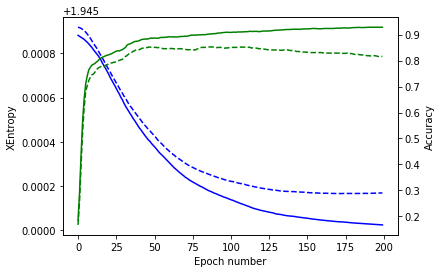

In [0]:
# Representación de los resultados
fig, ax = plt.subplots()

ax.set_ylabel("XEntropy")
ax.set_xlabel("Epoch number")
ax.plot([l['train'] for l in losses], "b", label = "XEntropy [train]")
ax.plot([l['val'] for l in losses], "b--", label = "XEntropy [val]")

ax_2 = ax.twinx()
ax_2.set_ylabel("Accuracy")

ax_2.plot([a['train'] for a in accuracy], "g", label = "Accuracy [train]")
ax_2.plot([a['val'] for a in accuracy], "g--", label = "Accuray [val]")

plt.show()